In [ ]:
import os 
os.chdir(r'Q:\sachuriga\Sachuriga_Python/quattrocolo-nwb4fp\src')

from neurochat.nc_data import NData
from neurochat.nc_spike import NSpike
from neurochat.nc_spatial import NSpatial
import neurochat.nc_plot as nc_plot
from neurochat.nc_lfp import NLfp
import matplotlib.pyplot as plt
import numpy as np
from pynwb import NWBHDF5IO
import matplotlib.pyplot as plt
import numpy as np
import math
import pynapple as nap
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import normalize

import sys
import nwb4fp.analyses.maps as mapp
from nwb4fp.analyses.examples.tracking_plot import plot_ratemap,plot_path
from nwb4fp.analyses.fields import separate_fields_by_laplace, separate_fields_by_dilation,find_peaks,separate_fields_by_laplace_of_gaussian,calculate_field_centers,distance_to_edge_function, remove_fields_by_area, map_pass_to_unit_circle,which_field,compute_crossings
from elephant.statistics import time_histogram, instantaneous_rate
from nwb4fp.analyses import maps
from nwb4fp.analyses.data import pos2speed,speed_filtered_spikes,load_speed_fromNWB,load_units_fromNWB,get_filed_num,unit_location_ch
from scipy.ndimage import gaussian_filter
import ast
import pandas as pd
pd.set_option('display.max_rows', None)
np.set_printoptions(threshold=np.inf)
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import pandas as pd

ModuleNotFoundError: No module named 'h5py'

In [ ]:
import pandas as pd
df_loaded = pd.read_pickle(r'Q:/sachuriga/CR_CA1_paper/tables/files_with_unit_tables.pkl')
df_loaded.head()

In [1]:
import pandas as pd
df_loaded = pd.read_pickle(r'Q:/sachuriga/CR_CA1_paper/tables/all_units_table.pkl')
len(df_loaded)
df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[df_good['cell_type']=="Pyramidal cells"]

In [ ]:
con_fis = [145,168,211]
exp_fis = [27,41,46]

con_blade = [280,304,318]
exp_blade = [26,42,91]

con_fis_and_bla = [182,200,237]
exp_fis_and_bla = [27,41,56]

Fis: statistic = 1.9639610121239315 p-value = 0.049534613435626706
Blade: statistic = 1.9639610121239315 p-value = 0.049534613435626706
Fis_and_bla: statistic = 1.9639610121239315 p-value = 0.049534613435626706


C:\Users\sachur\AppData\Local\Temp\ipykernel_18144\3765839021.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=group_fis, y=data_fis, ax=ax1, palette=['black', 'grey'], alpha=0.6)
C:\Users\sachur\AppData\Local\Temp\ipykernel_18144\3765839021.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=group_blade, y=data_blade, ax=ax2, palette=['black', 'grey'], alpha=0.6)
C:\Users\sachur\AppData\Local\Temp\ipykernel_18144\3765839021.py:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=group_fis_bla, y=data_fis_bla, ax=ax3, palette=['black

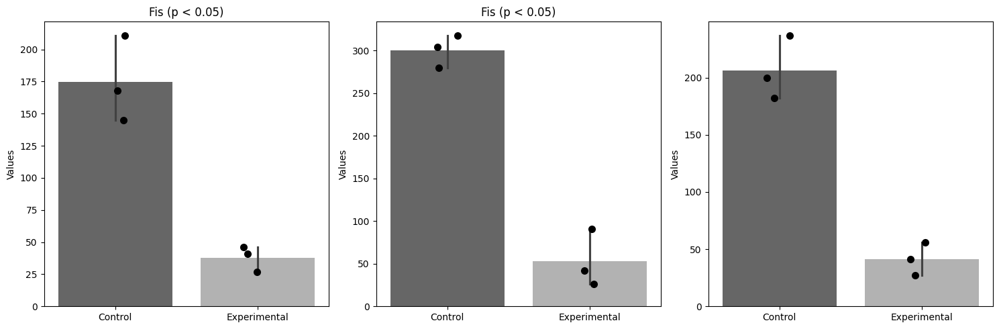

In [ ]:
import numpy as np
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt

# Data
con_fis = [145, 168, 211]
exp_fis = [27, 41, 46]

con_blade = [280, 304, 318]
exp_blade = [26, 42, 91]

con_fis_and_bla = [182, 200, 237]
exp_fis_and_bla = [27, 41, 56]

# Perform ranksum tests
fis_stat, fis_p = stats.ranksums(con_fis, exp_fis,alternative='two-sided')
blade_stat, blade_p = stats.ranksums(con_blade, exp_blade,alternative='two-sided')
fis_bla_stat, fis_bla_p = stats.ranksums(con_fis_and_bla, exp_fis_and_bla,alternative='two-sided')

# Print results
print("Fis: statistic =", fis_stat, "p-value =", fis_p)
print("Blade: statistic =", blade_stat, "p-value =", blade_p)
print("Fis_and_bla: statistic =", fis_bla_stat, "p-value =", fis_bla_p)

# Prepare data for plotting
data_fis = np.concatenate([con_fis, exp_fis])
data_blade = np.concatenate([con_blade, exp_blade])
data_fis_bla = np.concatenate([con_fis_and_bla, exp_fis_and_bla])

group_fis = ['Control']*len(con_fis) + ['Experimental']*len(exp_fis)
group_blade = ['Control']*len(con_blade) + ['Experimental']*len(exp_blade)
group_fis_bla = ['Control']*len(con_fis_and_bla) + ['Experimental']*len(exp_fis_and_bla)

# Create figure with 3 subplots
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

# Plot Fis
sns.barplot(x=group_fis, y=data_fis, ax=ax1, palette=['black', 'grey'], alpha=0.6)
sns.stripplot(x=group_fis, y=data_fis, ax=ax1, color='black', size=8)
if fis_p < 0.05:  
    ax1.set_title(f'Fis (p < 0.05)')
else:
    ax1.set_title(f'Fis (p={fis_p:.3f})')
ax1.set_ylabel('Values')
ax1.set_ylabel('Values')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(True)
ax1.spines['left'].set_visible(True)

# Plot Blade
sns.barplot(x=group_blade, y=data_blade, ax=ax2, palette=['black', 'grey'], alpha=0.6)
sns.stripplot(x=group_blade, y=data_blade, ax=ax2, color='black', size=8)
if blade_p< 0.05:
    ax2.set_title(f'Fis (p < 0.05)')
else:
    ax2.set_title(f'Blade (p={blade_p:.3f})')
ax2.set_ylabel('Values')
ax2.set_ylabel('Values')
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['bottom'].set_visible(True)
ax2.spines['left'].set_visible(True)

# Plot Fis_and_bla
sns.barplot(x=group_fis_bla, y=data_fis_bla, ax=ax3, palette=['black', 'grey'], alpha=0.6)
sns.stripplot(x=group_fis_bla, y=data_fis_bla, ax=ax3, color='black', size=8)
if blade_p< 0.05:
    ax3.set_title(f'Fis (p < 0.05)')
else:
    ax3.set_title(f'Fis_and_bla (p={fis_bla_p:.3f})')
ax3.set_ylabel('Values')
ax3.spines['top'].set_visible(False)
ax3.spines['right'].set_visible(False)
ax3.spines['bottom'].set_visible(True)
ax3.spines['left'].set_visible(True)

plt.tight_layout()
plt.show()

In [25]:
indi_df = df_loaded[df_loaded['animal_id']=="65165"]
indi_df

,spike_times,unit_name,sd_ratio,sync_spike_8.1,presence_ratio,cluster_id.30,half_width,l_ratio.1,recovery_slope.1,cluster_id.19,...,animal_id,session_id,cell_type,functional_cell_type,genotype,experimenter,sex,cell_type_group_6_group,cell_type_group_2_group,session
1455,"[273.29136666666665, 273.29176666666666, 273.3...",0,22.553692,0.0,0.50,0.0,0.000087,NaN,-2.850704e+05,0.0,...,65165,65165_2023-06-29_17-02-50_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
1456,"[28.6233, 28.624833333333335, 66.3099666666666...",1,13.319491,0.0,0.75,1.0,0.000103,4.533865,-2.323111e+05,1.0,...,65165,65165_2023-06-29_17-02-50_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
1457,"[17.578866666666666, 17.582766666666668, 17.58...",2,0.953895,0.0,1.00,2.0,0.000173,0.891252,-1.260586e+04,2.0,...,65165,65165_2023-06-29_17-02-50_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
1458,"[17.605666666666668, 17.682566666666666, 17.69...",3,1.850079,0.0,1.00,3.0,0.000117,1.628795,-5.340889e+02,3.0,...,65165,65165_2023-06-29_17-02-50_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
1459,"[17.5731, 17.602566666666668, 17.681, 17.70603...",4,0.934257,0.0,1.00,4.0,0.000143,0.197162,-1.003975e+04,4.0,...,65165,65165_2023-06-29_17-02-50_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2046,"[7.961633333333333, 38.74653333333333, 44.6570...",15,3.128427,0.0,1.00,26.0,0.000610,0.735713,-5.754545e+04,26.0,...,65165,65165_2023-07-29_15-34-20_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
2047,"[35.686166666666665, 38.74463333333333, 38.778...",29,19.030849,0.0,1.00,27.0,0.000410,0.001485,-1.567081e+06,27.0,...,65165,65165_2023-07-29_15-34-20_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,0,0,A
2048,"[45.6642, 113.05863333333333, 157.555233333333...",5,32.130337,0.0,0.50,28.0,0.000437,NaN,-1.093382e+06,28.0,...,65165,65165_2023-07-29_15-34-20_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A
2049,"[7.9616, 7.963033333333334, 14.515633333333334...",30,3.858131,0.0,1.00,29.0,0.000317,0.673309,-1.105899e+05,29.0,...,65165,65165_2023-07-29_15-34-20_A_phy_k_manual.nwb,None,None,NDNF-flp-/- and Pde1c -/-,Sachuriga,M,None,None,A


In [2]:
##Load Good units
df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[df_good['cell_type']=="Pyramidal cells"]

In [9]:
df=df_py
session = "A"
if session == "Total":
    df_a = df
else:
    df_a = df[df['session'] == session]


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 2869.00, p-value: 0.6970

Comparison for recovery_slope:
Control mean: -144175.85 ± 6779.01
Experimental mean: -118373.28 ± 7294.75
Mann-Whitney U statistic: 2100.00, p-value: 0.0130

Comparison for repolarization_slope:
Control mean: 1206184.47 ± 60040.13
Experimental mean: 1058837.80 ± 74829.87
Mann-Whitney U statistic: 3313.00, p-value: 0.0403

Comparison for firing_range:
Control mean: 4.51 ± 0.30
Experimental mean: 6.26 ± 0.63
Mann-Whitney U statistic: 2232.00, p-value: 0.0465

Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.18 ± 0.01
Mann-Whitney U statistic: 2522.00, p-value: 0.3652


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 2586.50, p-value: 0.5065


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


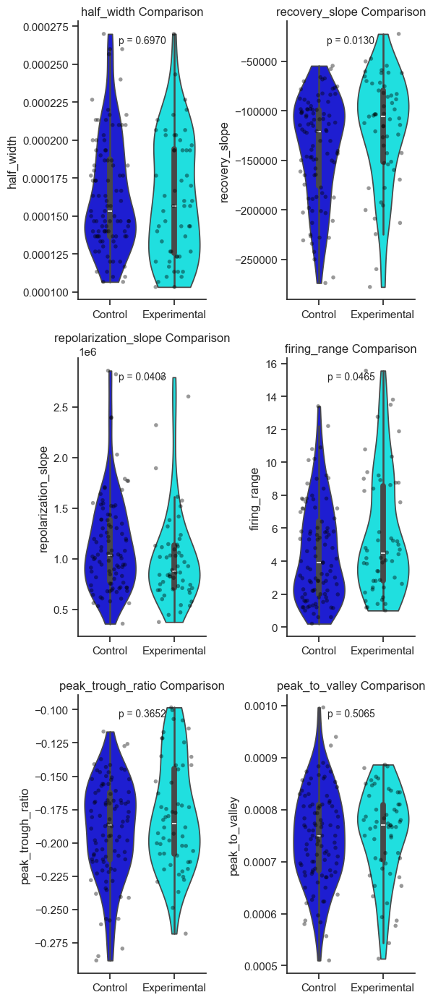


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 652.00, p-value: 0.7147

Comparison for recovery_slope:
Control mean: -121740.82 ± 9825.78
Experimental mean: -136569.19 ± 8367.99
Mann-Whitney U statistic: 756.00, p-value: 0.1162

Comparison for repolarization_slope:
Control mean: 1246465.18 ± 105230.95
Experimental mean: 1307882.59 ± 159837.94
Mann-Whitney U statistic: 671.00, p-value: 0.5582

Comparison for firing_range:
Control mean: 4.13 ± 0.41
Experimental mean: 4.82 ± 0.56
Mann-Whitney U statistic: 567.50, p-value: 0.5466

Comparison for peak_trough_ratio:
Control mean: -0.17 ± 0.01
Experimental mean: -0.17 ± 0.01
Mann-Whitney U statistic: 671.00, p-value: 0.5582


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 431.50, p-value: 0.0292


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


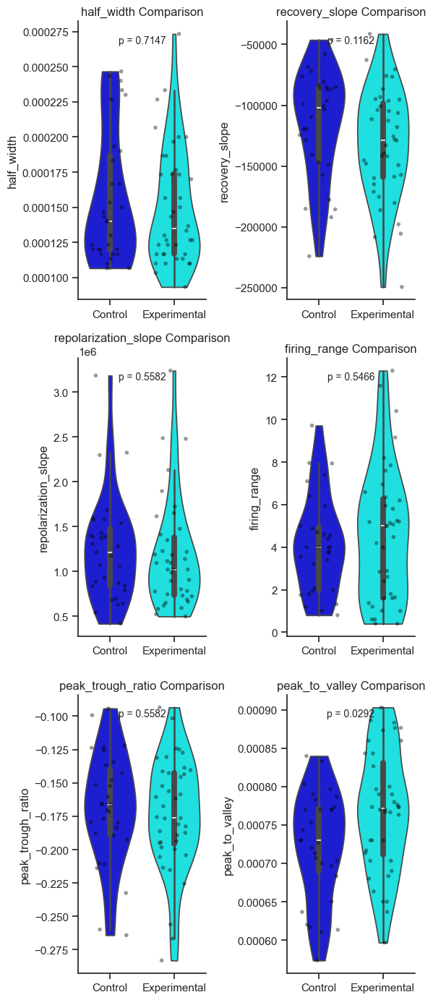


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 1257.00, p-value: 0.8070

Comparison for recovery_slope:
Control mean: -137697.34 ± 9820.34
Experimental mean: -136305.39 ± 8207.05
Mann-Whitney U statistic: 1153.00, p-value: 0.6427

Comparison for repolarization_slope:
Control mean: 1462144.70 ± 148489.98
Experimental mean: 1234256.35 ± 78226.50
Mann-Whitney U statistic: 1405.00, p-value: 0.2072

Comparison for firing_range:
Control mean: 4.13 ± 0.45
Experimental mean: 5.39 ± 0.44
Mann-Whitney U statistic: 986.00, p-value: 0.1070

Comparison for peak_trough_ratio:
Control mean: -0.17 ± 0.00
Experimental mean: -0.18 ± 0.00
Mann-Whitney U statistic: 1362.00, p-value: 0.3342


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 1185.50, p-value: 0.8098


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


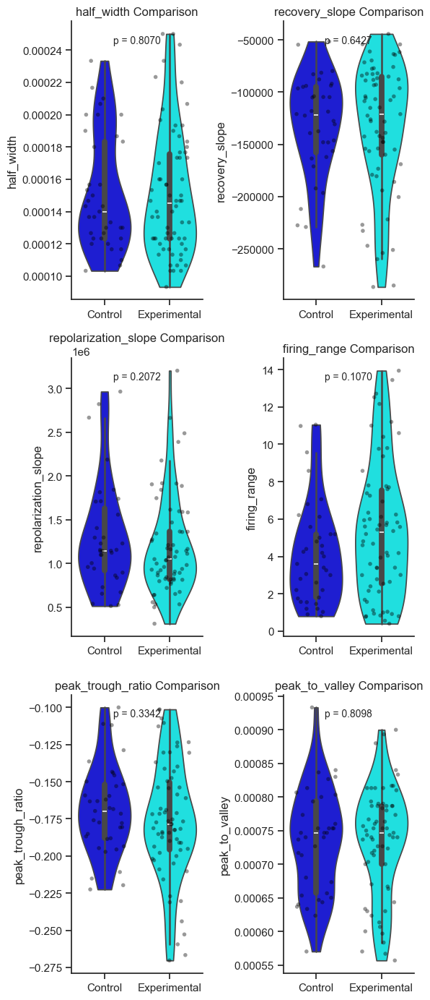


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 14664.50, p-value: 0.1564

Comparison for recovery_slope:
Control mean: -138508.02 ± 4931.28
Experimental mean: -130099.39 ± 4687.07
Mann-Whitney U statistic: 12379.00, p-value: 0.2136

Comparison for repolarization_slope:
Control mean: 1271149.50 ± 52651.11
Experimental mean: 1190981.46 ± 56951.28
Mann-Whitney U statistic: 15026.00, p-value: 0.0661

Comparison for firing_range:
Control mean: 4.36 ± 0.22
Experimental mean: 5.56 ± 0.32
Mann-Whitney U statistic: 11513.50, p-value: 0.0243

Comparison for peak_trough_ratio:
Control mean: -0.18 ± 0.00
Experimental mean: -0.18 ± 0.00
Mann-Whitney U statistic: 12849.00, p-value: 0.4862


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 12226.50, p-value: 0.1552


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


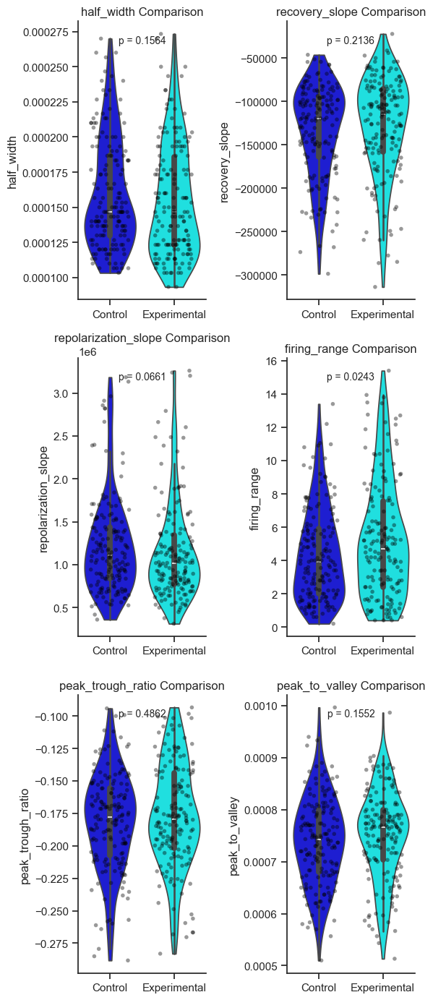


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 31254.50, p-value: 0.0490

Comparison for recovery_slope:
Control mean: -123530.20 ± 6663.05
Experimental mean: -132767.20 ± 24228.22
Mann-Whitney U statistic: 25978.00, p-value: 0.1231

Comparison for repolarization_slope:
Control mean: 1099382.47 ± 43184.73
Experimental mean: 1121359.20 ± 38706.07
Mann-Whitney U statistic: 25980.00, p-value: 0.1234

Comparison for firing_range:
Control mean: 5.26 ± 0.27
Experimental mean: 7.60 ± 0.44
Mann-Whitney U statistic: 22634.50, p-value: 0.0002

Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.18 ± 0.00
Mann-Whitney U statistic: 23651.00, p-value: 0.0020


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 29151.50, p-value: 0.5694


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


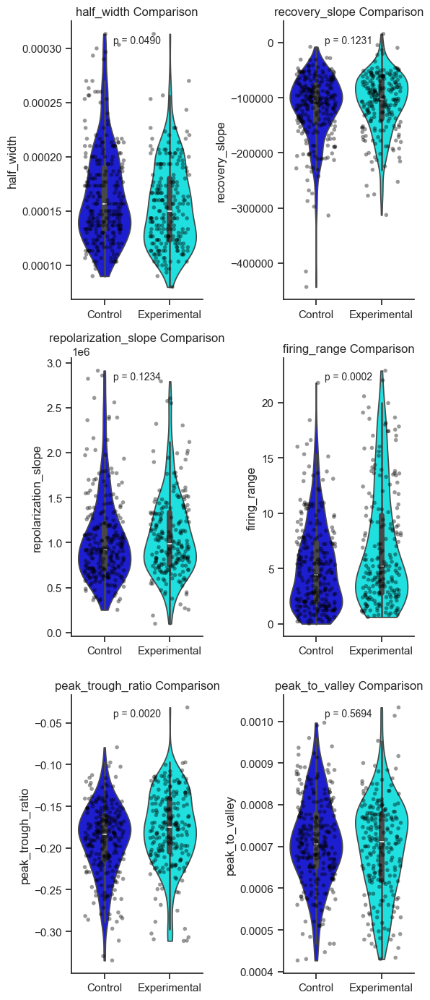


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 15419.00, p-value: 0.4011

Comparison for recovery_slope:
Control mean: -115154.22 ± 5151.77
Experimental mean: -112020.49 ± 3856.12
Mann-Whitney U statistic: 14614.00, p-value: 0.9736


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(



Comparison for repolarization_slope:
Control mean: 1085540.63 ± 48397.62
Experimental mean: 1152729.31 ± 48082.82
Mann-Whitney U statistic: 13828.00, p-value: 0.3757

Comparison for firing_range:
Control mean: 5.16 ± 0.30
Experimental mean: 7.91 ± 0.46
Mann-Whitney U statistic: 11308.50, p-value: 0.0003

Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 12486.00, p-value: 0.0192

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 13455.50, p-value: 0.1970


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i

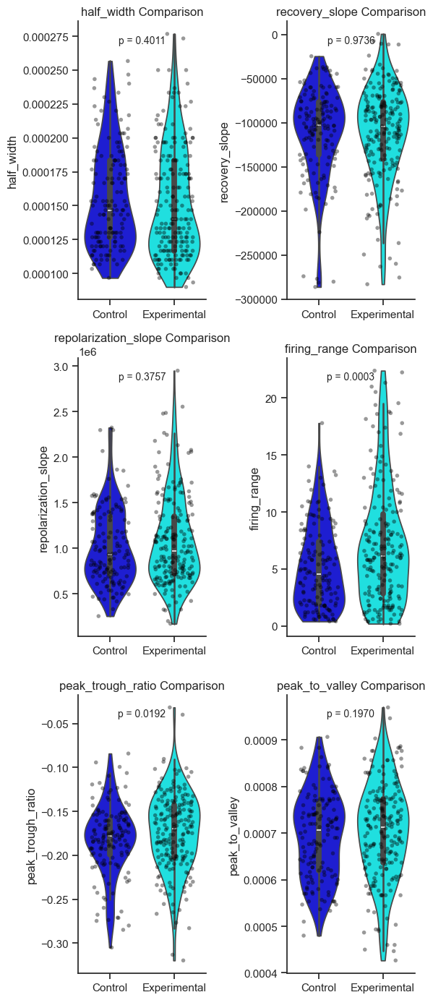


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 12465.50, p-value: 0.4698

Comparison for recovery_slope:
Control mean: -121483.68 ± 5344.07
Experimental mean: -109481.95 ± 4370.05
Mann-Whitney U statistic: 10124.00, p-value: 0.0248

Comparison for repolarization_slope:
Control mean: 1213608.46 ± 64978.69
Experimental mean: 1144094.67 ± 44900.06
Mann-Whitney U statistic: 12287.00, p-value: 0.6198

Comparison for firing_range:
Control mean: 4.91 ± 0.32
Experimental mean: 7.25 ± 0.44
Mann-Whitney U statistic: 9251.50, p-value: 0.0008

Comparison for peak_trough_ratio:
Control mean: -0.18 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 10678.00, p-value: 0.1231


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 12322.50, p-value: 0.5883


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


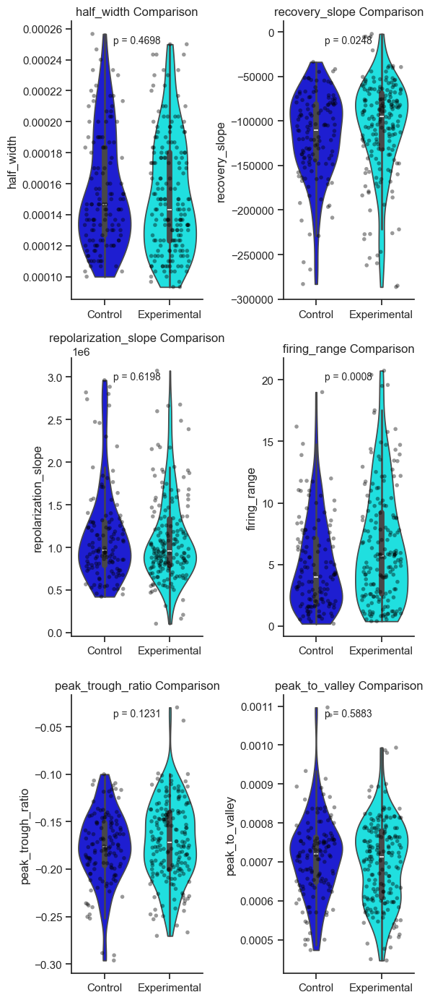


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 174865.00, p-value: 0.0147

Comparison for recovery_slope:
Control mean: -120773.09 ± 3762.95
Experimental mean: -118703.91 ± 8900.71
Mann-Whitney U statistic: 149076.00, p-value: 0.0264

Comparison for repolarization_slope:
Control mean: 1123297.39 ± 29392.20
Experimental mean: 1138825.68 ± 25293.62
Mann-Whitney U statistic: 153941.00, p-value: 0.1796

Comparison for firing_range:
Control mean: 5.15 ± 0.17
Experimental mean: 7.60 ± 0.26
Mann-Whitney U statistic: 126680.50, p-value: 0.0000


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed i


Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 136679.00, p-value: 0.0000

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 161453.50, p-value: 0.9878


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\3940683128.py:88: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


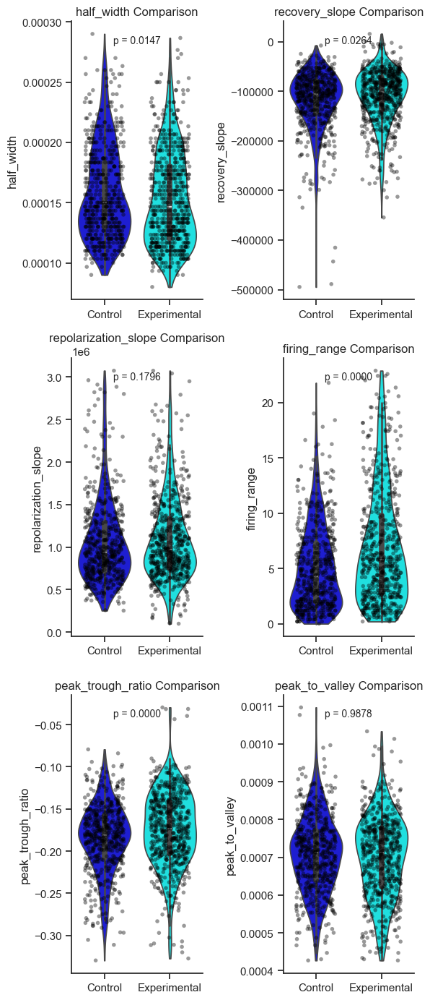

In [18]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
##Load Good units

df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[df_good['cell_type']=="Pyramidal cells"]

funct = ["Place cells",""]

for functional_plot in funct:
    if functional_plot :
        df = df_py[df_py['functional_cell_type']=="Place cell"]
    else:
        df = df_py

    base_folder = r"Q:/sachuriga/CR_CA1_paper/Results/cell_type"

    control_ids = ['65165', '65091', '63383', '66539', '65622']
    exp_ids = ['65588', '63385', '66538', '66537', '66922']

    session = ["A","B","C","Total"]

    for session in session:
        # Filter for 'A' sessions
        if session == "Total":
            df_a = df
        else:
            df_a = df[df['session'] == session]

        # Separate into control and experimental groups
        control_df = df_a[df_a['animal_id'].isin(control_ids)]
        exp_df = df_a[df_a['animal_id'].isin(exp_ids)]

        # Set Seaborn theme
        sns.set_theme(style="ticks")

        # Statistical comparisons for scalar metrics
        metrics = ['half_width', 'recovery_slope', 'repolarization_slope', 
                'firing_range', 'peak_trough_ratio', 'peak_to_valley']

        # Create figure with 3x2 subplots
        fig, axes = plt.subplots(3, 2, figsize=(6, 14))
        axes = axes.flatten()  # Flatten the 2D array of axes for easier iteration

        # Define custom colors
        control_color = sns.color_palette(palette='flag')[-1]  # Dark blue for Control
        #exp_color = sns.color_palette(palette='gist_rainbow')[3]       # Light blue for Experimental
        exp_color = "cyan"
        for idx, metric in enumerate(metrics):
            control_values = control_df[metric].dropna()
            exp_values = exp_df[metric].dropna()
            
            if len(control_values) > 0 and len(exp_values) > 0:
                control_mean = control_values.mean()
                exp_mean = exp_values.mean()
                control_sem = control_values.sem()
                exp_sem = exp_values.sem()
                
                print(f"\nComparison for {metric}:")
                print(f"Control mean: {control_mean:.2f} ± {control_sem:.2f}")
                print(f"Experimental mean: {exp_mean:.2f} ± {exp_sem:.2f}")
                
                # Mann-Whitney U test
                u_stat, p_val = stats.mannwhitneyu(control_values, exp_values, alternative='two-sided')
                print(f"Mann-Whitney U statistic: {u_stat:.2f}, p-value: {p_val:.4f}")
                
                # Prepare data for Seaborn plotting
                plot_df = pd.DataFrame({
                    'value': pd.concat([control_values, exp_values]),
                    'group': ['Control'] * len(control_values) + ['Experimental'] * len(exp_values)
                })
                
                # Check if deviation is "too large" (using coefficient of variation > 1 as threshold)
                all_values = plot_df['value']
                cv = all_values.std() / all_values.mean()  # Coefficient of variation
                use_log_scale = cv > 1 and all_values.min() > 0  # Ensure positive values for log scale
                
                # Filter out outliers (e.g., beyond 3 standard deviations)
                mean_val = all_values.mean()
                std_val = all_values.std()
                plot_df_filtered = plot_df[(plot_df['value'] >= mean_val - 3 * std_val) & 
                                        (plot_df['value'] <= mean_val + 3 * std_val)]
                
                # Create violin plot on the specific subplot
                violin = sns.violinplot(
                    data=plot_df_filtered,
                    x='group',
                    y='value',
                    ax=axes[idx],
                    palette={"Control": control_color, "Experimental": exp_color},
                    width=0.8,
                    cut=0  # Prevents violin tails from extending beyond data range
                )
                
                # Set alpha (transparency) for the violin plot
                for patch in violin.collections:
                    patch.set_alpha(1)
                
                # Add individual points with matching colors
                sns.stripplot(
                    data=plot_df_filtered,
                    x='group',
                    y='value',
                    ax=axes[idx],
                    size=4,
                    hue='group',
                    palette={"Control": "black", "Experimental": "black"},
                    alpha=0.4,
                    jitter=0.3,
                    legend=False
                )
                
                # Set title and labels
                axes[idx].set_title(f'{metric} Comparison')
                axes[idx].set_ylabel(metric)
                axes[idx].set_xlabel('Group')
                axes[idx].yaxis.grid(False)
                axes[idx].set(xlabel="")
                
                # Apply log scale if deviation is too large
                if use_log_scale:
                    axes[idx].set_yscale('log')
                    axes[idx].set_ylabel(f'{metric} (log scale)')
                
                # Add p-value at the top of the plot
                axes[idx].text(0.5, 0.95, f'p = {p_val:.4f}', 
                            horizontalalignment='center', 
                            verticalalignment='top', 
                            transform=axes[idx].transAxes, 
                            fontsize=10)
                
                # Remove top and right spines, keep bottom (x) and left (y) axes
                axes[idx].spines['top'].set_visible(False)
                axes[idx].spines['right'].set_visible(False)
                axes[idx].spines['bottom'].set_visible(True)
                axes[idx].spines['left'].set_visible(True)

        # Save the figure
        fig.savefig(fr'{base_folder}/{session}_waveforms_pyramidal_{functional_plot}.eps', format='eps', bbox_inches='tight')
        fig.savefig(fr'{base_folder}/{session}_waveforms_pyramidal_{functional_plot}.png', format='png', bbox_inches='tight')

        # Adjust layout to prevent overlap
        plt.tight_layout()
        plt.show()

In [22]:
df_good 

,spike_times,unit_name,sd_ratio,sync_spike_8.1,presence_ratio,cluster_id.30,half_width,l_ratio.1,recovery_slope.1,cluster_id.19,...,animal_id,session_id,cell_type,functional_cell_type,genotype,experimenter,sex,cell_type_group_6_group,cell_type_group_2_group,session
0,"[53.421866666666666, 54.1465, 61.9342333333333...",41,1.665216,0.000000,0.975610,0.0,0.000103,4.376648e-05,-2.087518e+05,0.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,Place cell,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A
1,"[52.239733333333334, 52.245, 52.2489, 53.17986...",47,2.558734,0.000000,1.000000,1.0,0.000143,9.769963e-18,-1.802566e+05,1.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A
2,"[49.5235, 49.52916666666667, 49.5744, 49.58223...",60,1.512081,0.000000,1.000000,2.0,0.000123,0.000000e+00,-1.507319e+05,2.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Narrow spike interneuron,Speed cell,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,3,3,A
3,"[49.632333333333335, 49.638466666666666, 49.65...",1,1.594608,0.000000,1.000000,3.0,0.000210,2.043745e-03,-4.907542e+04,3.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Wide Spike Interneurons,Speed cell,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,5,3,A
5,"[49.5356, 49.56426666666667, 49.57673333333334...",4,0.978401,0.000000,1.000000,5.0,0.000133,1.016816e-02,-8.913278e+04,5.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Narrow spike interneuron,Speed cell,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,3,3,A
6,"[49.5398, 49.547, 49.5604, 49.65533333333333, ...",8,1.036041,0.000000,1.000000,6.0,0.000167,7.780387e-04,-5.680171e+04,6.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A
7,"[49.600366666666666, 49.743833333333335, 49.75...",12,1.113268,0.000000,1.000000,7.0,0.000150,6.050020e-07,-1.359625e+05,7.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Narrow spike interneuron,normal_int,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,3,3,A
8,"[50.3438, 50.802933333333335, 51.4826, 52.1020...",14,5.749932,0.000000,1.000000,8.0,0.000147,4.987387e-09,-1.294631e+05,8.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A
9,"[49.632933333333334, 49.71693333333333, 49.915...",15,1.087160,0.000000,1.000000,9.0,0.000167,1.121190e-04,-1.495870e+05,9.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A
10,"[50.3486, 54.10816666666667, 54.11566666666667...",16,7.262043,0.000000,1.000000,10.0,0.000253,7.132449e-05,-1.141700e+05,10.0,...,66922,66922_2024-09-25_15-39-48_A_phy_k_manual.nwb,Pyramidal cells,normal_py,NDNF-flp +/- and Pde1c +/-,Ingvild Lynneberg Glærum,F,1,1,A



Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 5441.00, p-value: 0.3068

Comparison for recovery_slope:
Control mean: -126497.95 ± 11911.86
Experimental mean: -125340.05 ± 8280.24
Mann-Whitney U statistic: 6303.00, p-value: 0.4056

Comparison for repolarization_slope:
Control mean: 2744141.73 ± 164703.39
Experimental mean: 2471906.83 ± 164154.96
Mann-Whitney U statistic: 6469.00, p-value: 0.2345

Comparison for firing_range:
Control mean: 19.88 ± 1.05
Experimental mean: 18.47 ± 1.27
Mann-Whitney U statistic: 6472.00, p-value: 0.2319


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_trough_ratio:
Control mean: -0.28 ± 0.01
Experimental mean: -0.33 ± 0.04
Mann-Whitney U statistic: 6529.00, p-value: 0.1875

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 5439.50, p-value: 0.3056


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


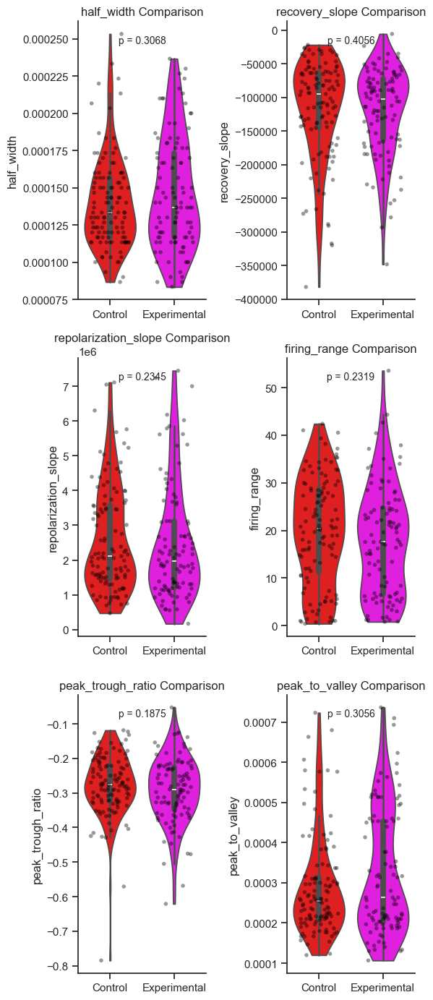


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 2398.50, p-value: 0.2163

Comparison for recovery_slope:
Control mean: -129077.05 ± 8716.73
Experimental mean: -125120.64 ± 9812.32
Mann-Whitney U statistic: 2543.00, p-value: 0.4971

Comparison for repolarization_slope:
Control mean: 2917235.83 ± 222582.50
Experimental mean: 2536100.36 ± 188512.38
Mann-Whitney U statistic: 3100.00, p-value: 0.1442

Comparison for firing_range:
Control mean: 18.64 ± 1.29
Experimental mean: 17.10 ± 1.22
Mann-Whitney U statistic: 2931.00, p-value: 0.4180

Comparison for peak_trough_ratio:
Control mean: -0.28 ± 0.01
Experimental mean: -0.33 ± 0.04
Mann-Whitney U statistic: 2881.00, p-value: 0.5369


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 2621.00, p-value: 0.7046


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


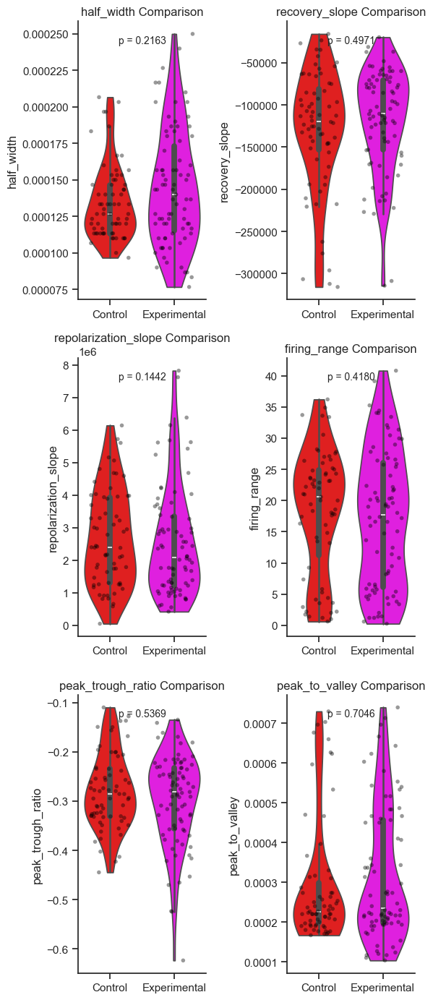


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 1963.00, p-value: 0.2837

Comparison for recovery_slope:
Control mean: -128129.84 ± 10086.54
Experimental mean: -122718.77 ± 8572.05
Mann-Whitney U statistic: 2070.00, p-value: 0.5561

Comparison for repolarization_slope:
Control mean: 2782466.52 ± 190951.26
Experimental mean: 2604130.36 ± 215206.42
Mann-Whitney U statistic: 2475.00, p-value: 0.2174

Comparison for firing_range:
Control mean: 20.48 ± 1.69
Experimental mean: 16.38 ± 1.28
Mann-Whitney U statistic: 2494.50, p-value: 0.1863

Comparison for peak_trough_ratio:
Control mean: -0.30 ± 0.01
Experimental mean: -0.29 ± 0.01
Mann-Whitney U statistic: 2182.00, p-value: 0.9335


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 2143.50, p-value: 0.7971


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


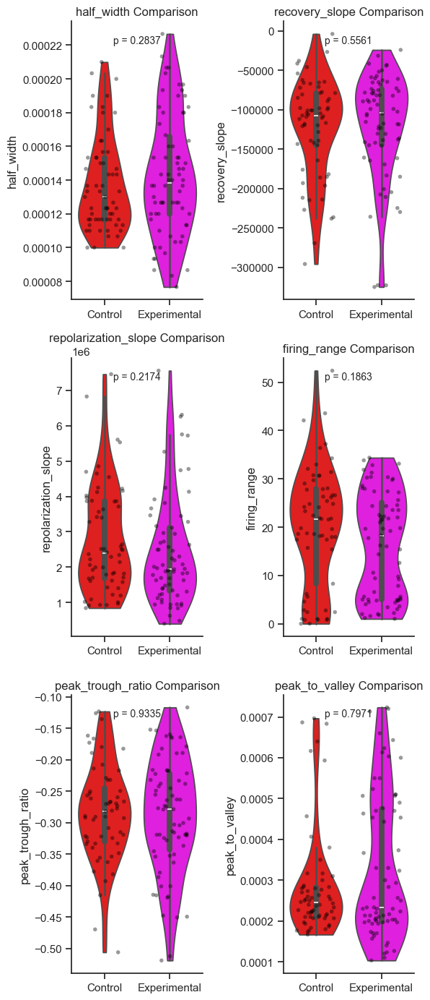


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 28123.00, p-value: 0.0627

Comparison for recovery_slope:
Control mean: -127622.16 ± 6598.41
Experimental mean: -124535.05 ± 5133.81
Mann-Whitney U statistic: 31036.00, p-value: 0.9591

Comparison for repolarization_slope:
Control mean: 2801647.97 ± 109814.57
Experimental mean: 2529311.39 ± 107232.39
Mann-Whitney U statistic: 34597.00, p-value: 0.0308

Comparison for firing_range:
Control mean: 19.69 ± 0.74
Experimental mean: 17.45 ± 0.73
Mann-Whitney U statistic: 34470.00, p-value: 0.0375

Comparison for peak_trough_ratio:
Control mean: -0.28 ± 0.01
Experimental mean: -0.32 ± 0.02
Mann-Whitney U statistic: 33089.00, p-value: 0.2213


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 29525.00, p-value: 0.3223


C:\Users\sachur\AppData\Local\Temp\ipykernel_11000\389789069.py:82: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


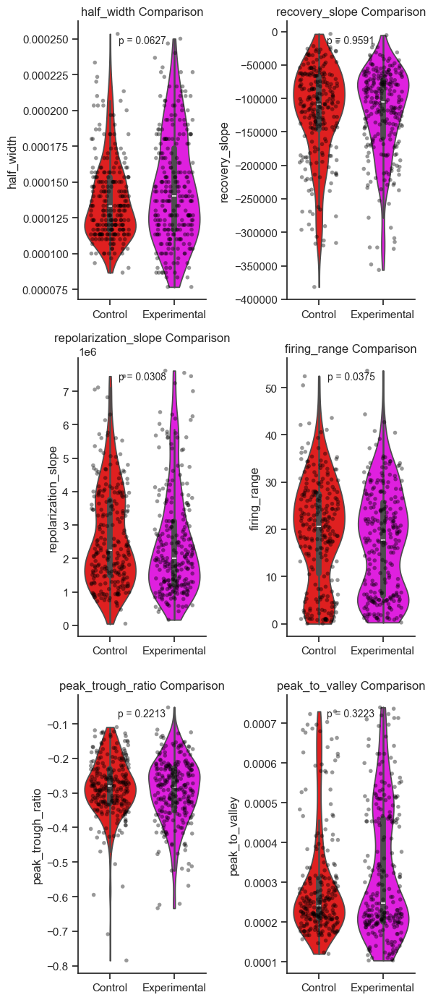

In [29]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
##Load Good units

df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[(df_good['cell_type']=="Narrow spike interneuron")|(df_good['cell_type']=="Wide Spike Interneurons")]

df = df_py

base_folder = r"Q:/sachuriga/CR_CA1_paper/Results/cell_type"

control_ids = ['65165', '65091', '63383', '66539', '65622']
exp_ids = ['65588', '63385', '66538', '66537', '66922']

session = ["A","B","C","Total"]

for session in session:
    # Filter for 'A' sessions
    if session == "Total":
        df_a = df
    else:
        df_a = df[df['session'] == session]

    # Separate into control and experimental groups
    control_df = df_a[df_a['animal_id'].isin(control_ids)]
    exp_df = df_a[df_a['animal_id'].isin(exp_ids)]

    # Set Seaborn theme
    sns.set_theme(style="ticks")

    # Statistical comparisons for scalar metrics
    metrics = ['half_width', 'recovery_slope', 'repolarization_slope', 
            'firing_range', 'peak_trough_ratio', 'peak_to_valley']

    # Create figure with 3x2 subplots
    fig, axes = plt.subplots(3, 2, figsize=(6, 14))
    axes = axes.flatten()  # Flatten the 2D array of axes for easier iteration

    # Define custom colors
    control_color = "red"  # Dark blue for Control
    #exp_color = sns.color_palette(palette='gist_rainbow')[3]       # Light blue for Experimental
    exp_color = "magenta"
    for idx, metric in enumerate(metrics):
        control_values = control_df[metric].dropna()
        exp_values = exp_df[metric].dropna()
        
        if len(control_values) > 0 and len(exp_values) > 0:
            control_mean = control_values.mean()
            exp_mean = exp_values.mean()
            control_sem = control_values.sem()
            exp_sem = exp_values.sem()
            
            print(f"\nComparison for {metric}:")
            print(f"Control mean: {control_mean:.2f} ± {control_sem:.2f}")
            print(f"Experimental mean: {exp_mean:.2f} ± {exp_sem:.2f}")
            
            # Mann-Whitney U test
            u_stat, p_val = stats.mannwhitneyu(control_values, exp_values, alternative='two-sided')
            print(f"Mann-Whitney U statistic: {u_stat:.2f}, p-value: {p_val:.4f}")
            
            # Prepare data for Seaborn plotting
            plot_df = pd.DataFrame({
                'value': pd.concat([control_values, exp_values]),
                'group': ['Control'] * len(control_values) + ['Experimental'] * len(exp_values)
            })
            
            # Check if deviation is "too large" (using coefficient of variation > 1 as threshold)
            all_values = plot_df['value']
            cv = all_values.std() / all_values.mean()  # Coefficient of variation
            use_log_scale = cv > 1 and all_values.min() > 0  # Ensure positive values for log scale
            
            # Filter out outliers (e.g., beyond 3 standard deviations)
            mean_val = all_values.mean()
            std_val = all_values.std()
            plot_df_filtered = plot_df[(plot_df['value'] >= mean_val - 3 * std_val) & 
                                    (plot_df['value'] <= mean_val + 3 * std_val)]
            
            # Create violin plot on the specific subplot
            violin = sns.violinplot(
                data=plot_df_filtered,
                x='group',
                y='value',
                ax=axes[idx],
                palette={"Control": control_color, "Experimental": exp_color},
                width=0.8,
                cut=0  # Prevents violin tails from extending beyond data range
            )
            
            # Set alpha (transparency) for the violin plot
            for patch in violin.collections:
                patch.set_alpha(1)
            
            # Add individual points with matching colors
            sns.stripplot(
                data=plot_df_filtered,
                x='group',
                y='value',
                ax=axes[idx],
                size=4,
                hue='group',
                palette={"Control": "black", "Experimental": "black"},
                alpha=0.4,
                jitter=0.3,
                legend=False
            )
            
            # Set title and labels
            axes[idx].set_title(f'{metric} Comparison')
            axes[idx].set_ylabel(metric)
            axes[idx].set_xlabel('Group')
            axes[idx].yaxis.grid(False)
            axes[idx].set(xlabel="")
            
            # Apply log scale if deviation is too large
            if use_log_scale:
                axes[idx].set_yscale('log')
                axes[idx].set_ylabel(f'{metric} (log scale)')
            
            # Add p-value at the top of the plot
            axes[idx].text(0.5, 0.95, f'p = {p_val:.4f}', 
                        horizontalalignment='center', 
                        verticalalignment='top', 
                        transform=axes[idx].transAxes, 
                        fontsize=10)
            
            # Remove top and right spines, keep bottom (x) and left (y) axes
            axes[idx].spines['top'].set_visible(False)
            axes[idx].spines['right'].set_visible(False)
            axes[idx].spines['bottom'].set_visible(True)
            axes[idx].spines['left'].set_visible(True)

    # Save the figure
    fig.savefig(fr'{base_folder}/{session}_waveforms_interneuron.eps', format='eps', bbox_inches='tight')
    fig.savefig(fr'{base_folder}/{session}_waveforms_interneuron.png', format='png', bbox_inches='tight')

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

In [ ]:
df_py


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 31254.50, p-value: 0.0490

Comparison for recovery_slope:
Control mean: -123530.20 ± 6663.05
Experimental mean: -132767.20 ± 24228.22
Mann-Whitney U statistic: 25978.00, p-value: 0.1231

Comparison for repolarization_slope:
Control mean: 1099382.47 ± 43184.73
Experimental mean: 1121359.20 ± 38706.07
Mann-Whitney U statistic: 25980.00, p-value: 0.1234

Comparison for firing_range:
Control mean: 5.26 ± 0.27
Experimental mean: 7.60 ± 0.44
Mann-Whitney U statistic: 22634.50, p-value: 0.0002


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.18 ± 0.00
Mann-Whitney U statistic: 23651.00, p-value: 0.0020

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 29151.50, p-value: 0.5694


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


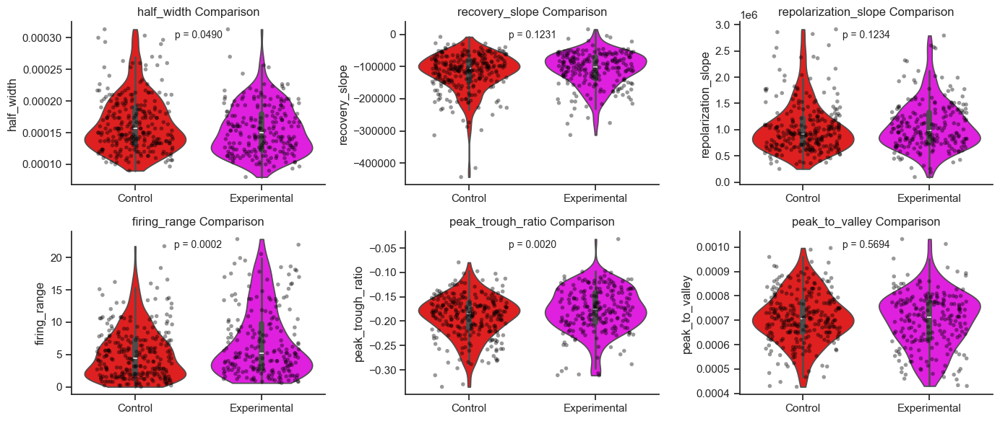


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 15419.00, p-value: 0.4011

Comparison for recovery_slope:
Control mean: -115154.22 ± 5151.77
Experimental mean: -112020.49 ± 3856.12
Mann-Whitney U statistic: 14614.00, p-value: 0.9736

Comparison for repolarization_slope:
Control mean: 1085540.63 ± 48397.62
Experimental mean: 1152729.31 ± 48082.82
Mann-Whitney U statistic: 13828.00, p-value: 0.3757

Comparison for firing_range:
Control mean: 5.16 ± 0.30
Experimental mean: 7.91 ± 0.46
Mann-Whitney U statistic: 11308.50, p-value: 0.0003

Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 12486.00, p-value: 0.0192

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0

Mann-Whitney U statistic: 13455.50, p-value: 0.1970


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


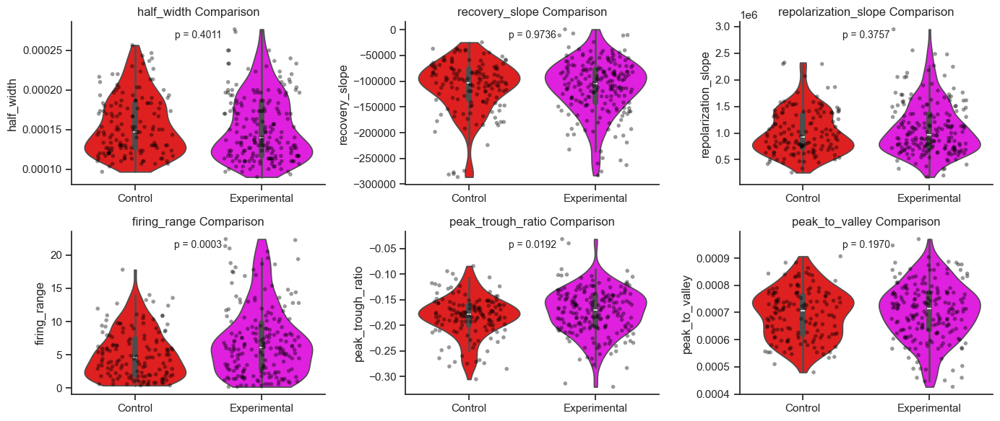


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 12465.50, p-value: 0.4698

Comparison for recovery_slope:
Control mean: -121483.68 ± 5344.07
Experimental mean: -109481.95 ± 4370.05
Mann-Whitney U statistic: 10124.00, p-value: 0.0248

Comparison for repolarization_slope:
Control mean: 1213608.46 ± 64978.69
Experimental mean: 1144094.67 ± 44900.06
Mann-Whitney U statistic: 12287.00, p-value: 0.6198

Comparison for firing_range:
Control mean: 4.91 ± 0.32
Experimental mean: 7.25 ± 0.44
Mann-Whitney U statistic: 9251.50, p-value: 0.0008

Comparison for peak_trough_ratio:
Control mean: -0.18 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 10678.00, p-value: 0.1231


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 12322.50, p-value: 0.5883


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


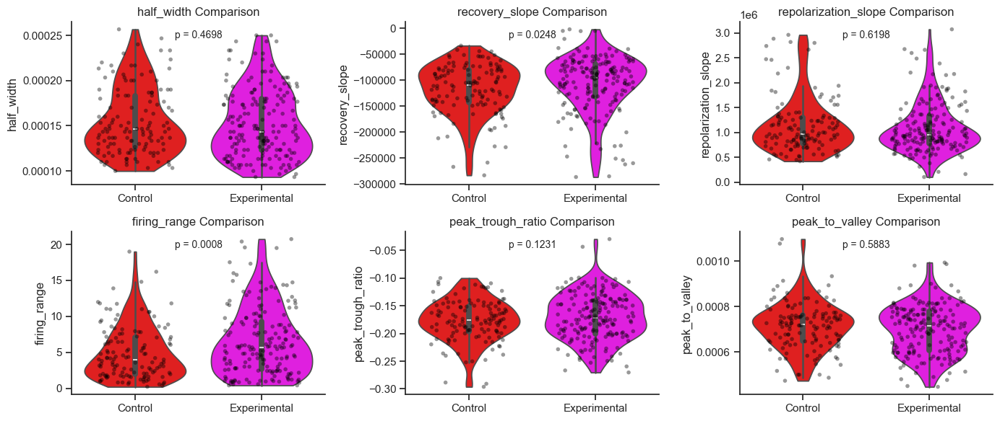


Comparison for half_width:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 174865.00, p-value: 0.0147

Comparison for recovery_slope:
Control mean: -120773.09 ± 3762.95
Experimental mean: -118703.91 ± 8900.71
Mann-Whitney U statistic: 149076.00, p-value: 0.0264

Comparison for repolarization_slope:
Control mean: 1123297.39 ± 29392.20
Experimental mean: 1138825.68 ± 25293.62
Mann-Whitney U statistic: 153941.00, p-value: 0.1796

Comparison for firing_range:
Control mean: 5.15 ± 0.17
Experimental mean: 7.60 ± 0.26
Mann-Whitney U statistic: 126680.50, p-value: 0.0000


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0


Comparison for peak_trough_ratio:
Control mean: -0.19 ± 0.00
Experimental mean: -0.17 ± 0.00
Mann-Whitney U statistic: 136679.00, p-value: 0.0000

Comparison for peak_to_valley:
Control mean: 0.00 ± 0.00
Experimental mean: 0.00 ± 0.00
Mann-Whitney U statistic: 161453.50, p-value: 0.9878


C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
C:\Users\sachur\AppData\Local\Temp\ipykernel_16688\720882003.py:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


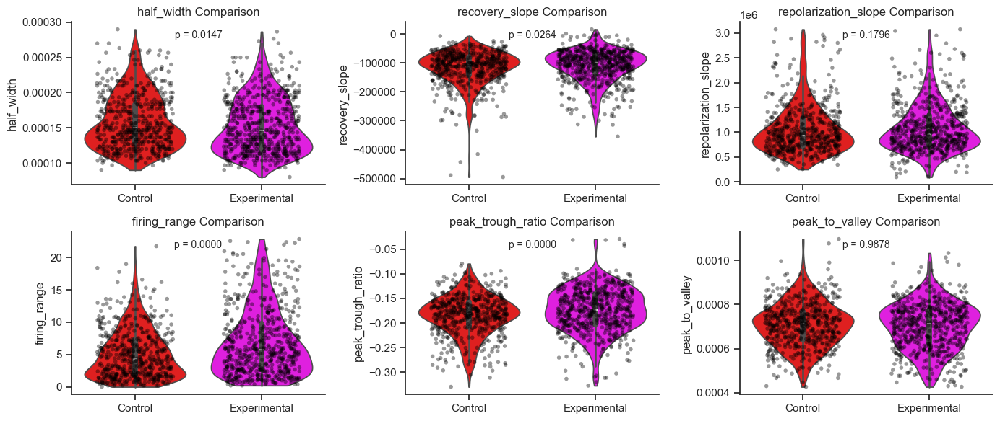

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
##Load Good units

df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[df_good['cell_type']=="Pyramidal cells"]

df = df_py[df_py['']]

base_folder = r"Q:/sachuriga/CR_CA1_paper/Results/cell_type"

control_ids = ['65165', '65091', '63383', '66539', '65622']
exp_ids = ['65588', '63385', '66538', '66537', '66922']

session = ["A","B","C","Total"]

for session in session:
    # Filter for 'A' sessions
    if session == "Total":
        df_a = df
    else:
        df_a = df[df['session'] == session]

    # Separate into control and experimental groups
    control_df = df_a[df_a['animal_id'].isin(control_ids)]
    exp_df = df_a[df_a['animal_id'].isin(exp_ids)]

    # Set Seaborn theme
    sns.set_theme(style="ticks")

    # Statistical comparisons for scalar metrics
    metrics = ['half_width', 'recovery_slope', 'repolarization_slope', 
            'firing_range', 'peak_trough_ratio', 'peak_to_valley']

    metrics1 = ['matlab_test_stat_si']
    
    # Create figure with 3x2 subplots
    fig, axes = plt.subplots(2, 3, figsize=(14,6))
    axes = axes.flatten()  # Flatten the 2D array of axes for easier iteration

    # Define custom colors
    control_color = "red"  # Dark blue for Control
    #exp_color = sns.color_palette(palette='gist_rainbow')[3]       # Light blue for Experimental
    exp_color = "magenta"
    for idx, metric in enumerate(metrics):
        control_values = control_df[metric].dropna()
        exp_values = exp_df[metric].dropna()
        
        if len(control_values) > 0 and len(exp_values) > 0:
            control_mean = control_values.mean()
            exp_mean = exp_values.mean()
            control_sem = control_values.sem()
            exp_sem = exp_values.sem()
            
            print(f"\nComparison for {metric}:")
            print(f"Control mean: {control_mean:.2f} ± {control_sem:.2f}")
            print(f"Experimental mean: {exp_mean:.2f} ± {exp_sem:.2f}")
            
            # Mann-Whitney U test
            u_stat, p_val = stats.mannwhitneyu(control_values, exp_values, alternative='two-sided')
            print(f"Mann-Whitney U statistic: {u_stat:.2f}, p-value: {p_val:.4f}")
            
            # Prepare data for Seaborn plotting
            plot_df = pd.DataFrame({
                'value': pd.concat([control_values, exp_values]),
                'group': ['Control'] * len(control_values) + ['Experimental'] * len(exp_values)
            })
            
            # Check if deviation is "too large" (using coefficient of variation > 1 as threshold)
            all_values = plot_df['value']
            cv = all_values.std() / all_values.mean()  # Coefficient of variation
            use_log_scale = cv > 1 and all_values.min() > 0  # Ensure positive values for log scale
            
            # Filter out outliers (e.g., beyond 3 standard deviations)
            mean_val = all_values.mean()
            std_val = all_values.std()
            plot_df_filtered = plot_df[(plot_df['value'] >= mean_val - 3 * std_val) & 
                                    (plot_df['value'] <= mean_val + 3 * std_val)]
            
            # Create violin plot on the specific subplot
            violin = sns.violinplot(
                data=plot_df_filtered,
                x='group',
                y='value',
                ax=axes[idx],
                palette={"Control": control_color, "Experimental": exp_color},
                width=0.8,
                cut=0  # Prevents violin tails from extending beyond data range
            )
            
            # Set alpha (transparency) for the violin plot
            for patch in violin.collections:
                patch.set_alpha(1)
            
            # Add individual points with matching colors
            sns.stripplot(
                data=plot_df_filtered,
                x='group',
                y='value',
                ax=axes[idx],
                size=4,
                hue='group',
                palette={"Control": "black", "Experimental": "black"},
                alpha=0.4,
                jitter=0.3,
                legend=False
            )
            
            # Set title and labels
            axes[idx].set_title(f'{metric} Comparison')
            axes[idx].set_ylabel(metric)
            axes[idx].set_xlabel('Group')
            axes[idx].yaxis.grid(False)
            axes[idx].set(xlabel="")
            
            # Apply log scale if deviation is too large
            if use_log_scale:
                axes[idx].set_yscale('log')
                axes[idx].set_ylabel(f'{metric} (log scale)')
            
            # Add p-value at the top of the plot
            axes[idx].text(0.5, 0.95, f'p = {p_val:.4f}', 
                        horizontalalignment='center', 
                        verticalalignment='top', 
                        transform=axes[idx].transAxes, 
                        fontsize=10)
            
            # Remove top and right spines, keep bottom (x) and left (y) axes
            axes[idx].spines['top'].set_visible(False)
            axes[idx].spines['right'].set_visible(False)
            axes[idx].spines['bottom'].set_visible(True)
            axes[idx].spines['left'].set_visible(True)

    # Save the figure
    fig.savefig(fr'{base_folder}/{session}_waveforms_interneuron.eps', format='eps', bbox_inches='tight')
    fig.savefig(fr'{base_folder}/{session}_waveforms_interneuron.png', format='png', bbox_inches='tight')

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()


A - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0162, n = 92
Experimental: slope = 0.0000 ± 0.0000, R² = 0.0170, n = 56
Slope difference z-statistic: -1.5452, p-value: 0.1223

A - recovery_slope (after outlier removal):
Control: slope = -14214.4908 ± 15190.9459, R² = 0.0097, n = 91
Experimental: slope = -15571.6321 ± 12600.9726, R² = 0.0280, n = 55
Slope difference z-statistic: 0.0688, p-value: 0.9452

A - repolarization_slope (after outlier removal):
Control: slope = 234196.3398 ± 121139.0503, R² = 0.0417, n = 88
Experimental: slope = 11969.1342 ± 79577.3879, R² = 0.0005, n = 52
Slope difference z-statistic: 1.5332, p-value: 0.1252

A - firing_range (after outlier removal):
Control: slope = -2.4378 ± 0.7802, R² = 0.0979, n = 92
Experimental: slope = -3.7033 ± 1.0092, R² = 0.1996, n = 56
Slope difference z-statistic: 0.9920, p-value: 0.3212

A - peak_trough_ratio (after outlier removal):
Control: slope = 0.0158 ± 0.0102, R² = 0.0265, n = 91
Experiment

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


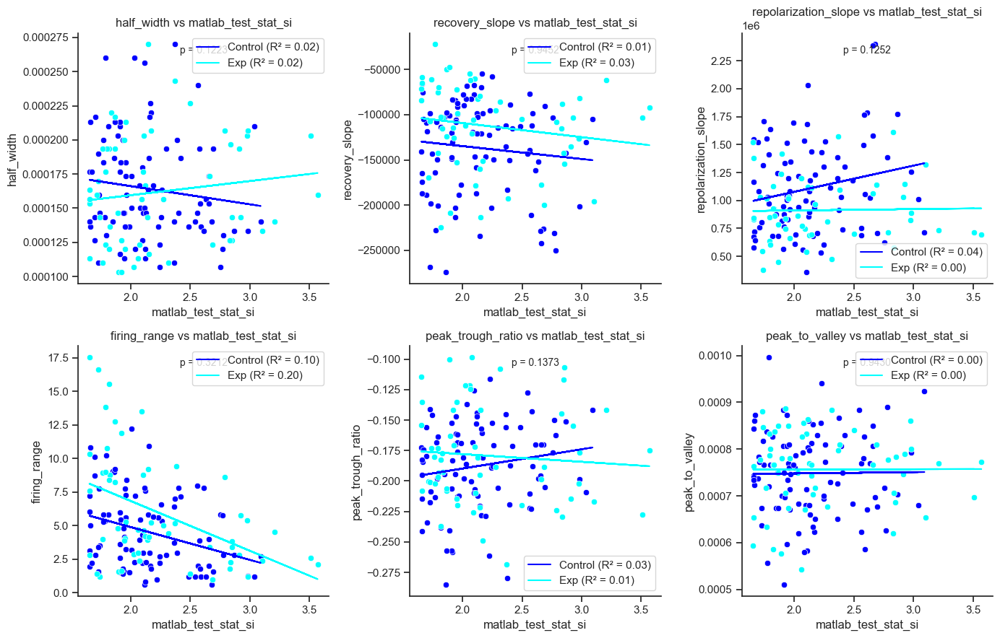


B - half_width (after outlier removal):
Control: slope = 0.0000 ± 0.0000, R² = 0.0112, n = 31
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0579, n = 37
Slope difference z-statistic: 1.4294, p-value: 0.1529

B - recovery_slope (after outlier removal):
Control: slope = -30112.6884 ± 21073.5887, R² = 0.0680, n = 30
Experimental: slope = -38692.0677 ± 24991.2321, R² = 0.0641, n = 37
Slope difference z-statistic: 0.2624, p-value: 0.7930

B - repolarization_slope (after outlier removal):
Control: slope = -63941.8009 ± 258493.5110, R² = 0.0022, n = 30
Experimental: slope = 295549.3895 ± 231713.6441, R² = 0.0484, n = 34
Slope difference z-statistic: -1.0356, p-value: 0.3004

B - firing_range (after outlier removal):
Control: slope = 1.1187 ± 0.9894, R² = 0.0437, n = 30
Experimental: slope = -2.8527 ± 1.8239, R² = 0.0653, n = 37
Slope difference z-statistic: 1.9139, p-value: 0.0556

B - peak_trough_ratio (after outlier removal):
Control: slope = 0.0018 ± 0.0188, R² = 0.0003, n = 30
Experimen

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


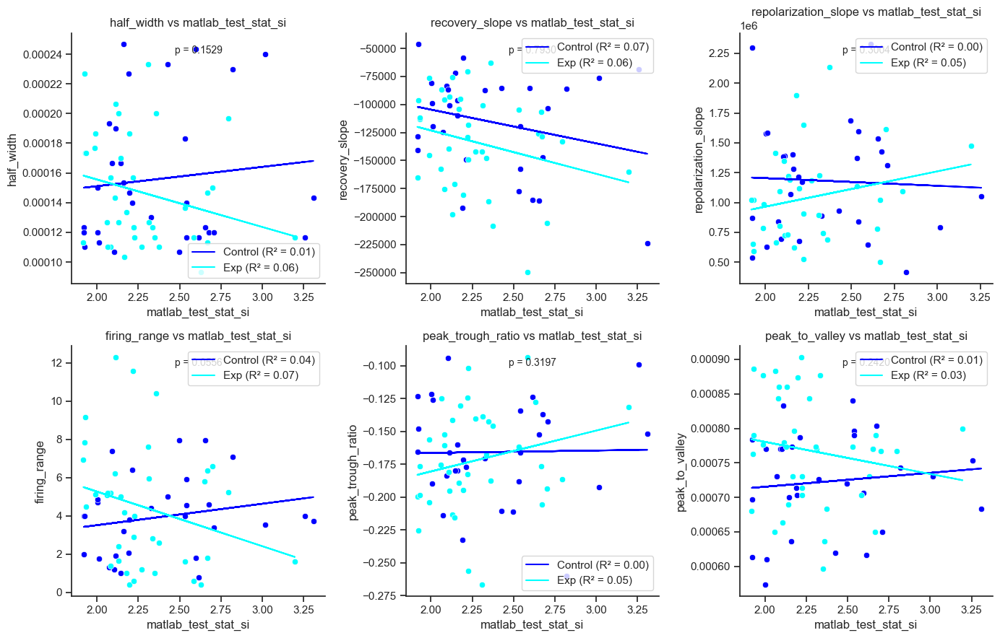


C - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0057, n = 34
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0473, n = 63
Slope difference z-statistic: 0.3705, p-value: 0.7110

C - recovery_slope (after outlier removal):
Control: slope = -41174.5079 ± 22513.5295, R² = 0.1003, n = 32
Experimental: slope = -35076.4651 ± 14204.6342, R² = 0.0895, n = 64
Slope difference z-statistic: -0.2291, p-value: 0.8188

C - repolarization_slope (after outlier removal):
Control: slope = 479760.9336 ± 313893.2271, R² = 0.0745, n = 31
Experimental: slope = 258632.1918 ± 102320.8795, R² = 0.0977, n = 61
Slope difference z-statistic: 0.6698, p-value: 0.5030

C - firing_range (after outlier removal):
Control: slope = -1.5628 ± 1.0929, R² = 0.0638, n = 32
Experimental: slope = -3.0768 ± 0.7526, R² = 0.2096, n = 65
Slope difference z-statistic: 1.1409, p-value: 0.2539

C - peak_trough_ratio (after outlier removal):
Control: slope = 0.0229 ± 0.0133, R² = 0.0852, n = 34
Experim

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


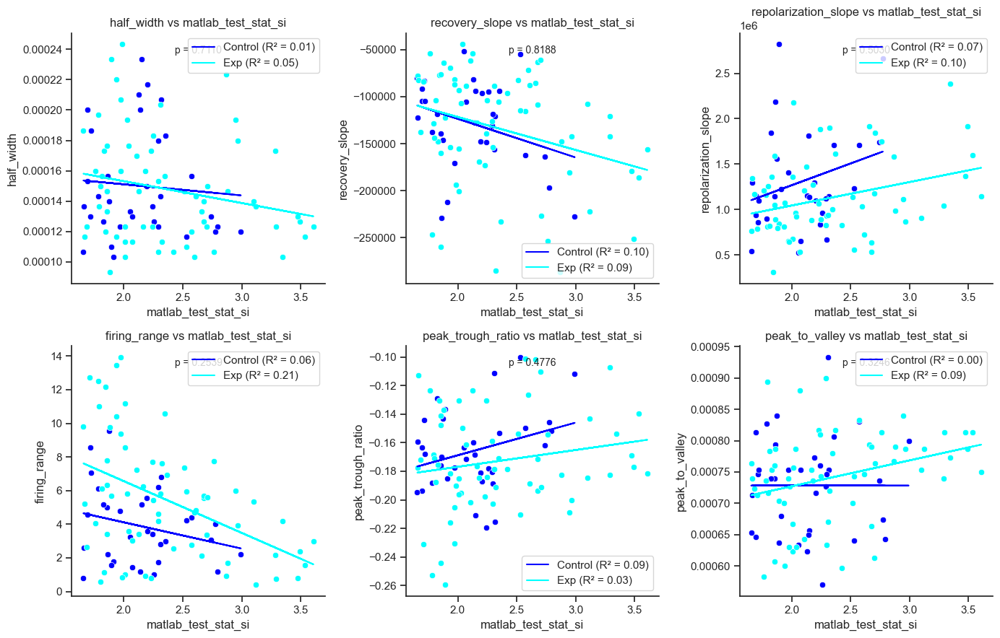


Total - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0001, n = 161
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0072, n = 161
Slope difference z-statistic: 0.6257, p-value: 0.5315

Total - recovery_slope (after outlier removal):
Control: slope = -14347.0173 ± 9545.4029, R² = 0.0145, n = 156
Experimental: slope = -23917.3622 ± 8410.8954, R² = 0.0496, n = 157
Slope difference z-statistic: 0.7522, p-value: 0.4519

Total - repolarization_slope (after outlier removal):
Control: slope = 82344.3134 ± 88076.1341, R² = 0.0058, n = 151
Experimental: slope = 127290.7434 ± 64625.2386, R² = 0.0257, n = 149
Slope difference z-statistic: -0.4114, p-value: 0.6808

Total - firing_range (after outlier removal):
Control: slope = -1.5786 ± 0.4979, R² = 0.0598, n = 160
Experimental: slope = -2.7231 ± 0.5405, R² = 0.1400, n = 158
Slope difference z-statistic: 1.5576, p-value: 0.1193

Total - peak_trough_ratio (after outlier removal):
Control: slope = 0.0057 ± 0.0070, R² =

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


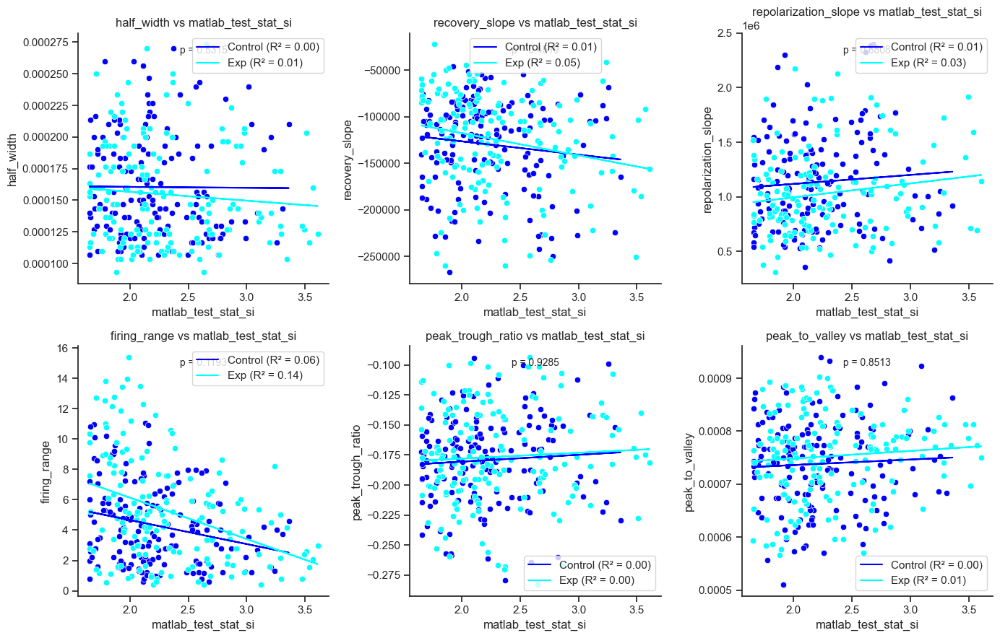


A - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0018, n = 252
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0004, n = 207
Slope difference z-statistic: -0.2309, p-value: 0.8174

A - recovery_slope (after outlier removal):
Control: slope = -29696.7996 ± 3255.4369, R² = 0.2528, n = 248
Experimental: slope = -18660.6838 ± 3939.3640, R² = 0.0991, n = 206
Slope difference z-statistic: -2.1595, p-value: 0.0308

A - repolarization_slope (after outlier removal):
Control: slope = 137523.2333 ± 28245.6054, R² = 0.0896, n = 243
Experimental: slope = 1484.4777 ± 35024.6678, R² = 0.0000, n = 201
Slope difference z-statistic: 3.0234, p-value: 0.0025

A - firing_range (after outlier removal):
Control: slope = -1.5199 ± 0.2658, R² = 0.1157, n = 252
Experimental: slope = -2.3785 ± 0.4434, R² = 0.1252, n = 203
Slope difference z-statistic: 1.6609, p-value: 0.0967

A - peak_trough_ratio (after outlier removal):
Control: slope = 0.0031 ± 0.0031, R² = 0.0040, n = 250
Exp

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


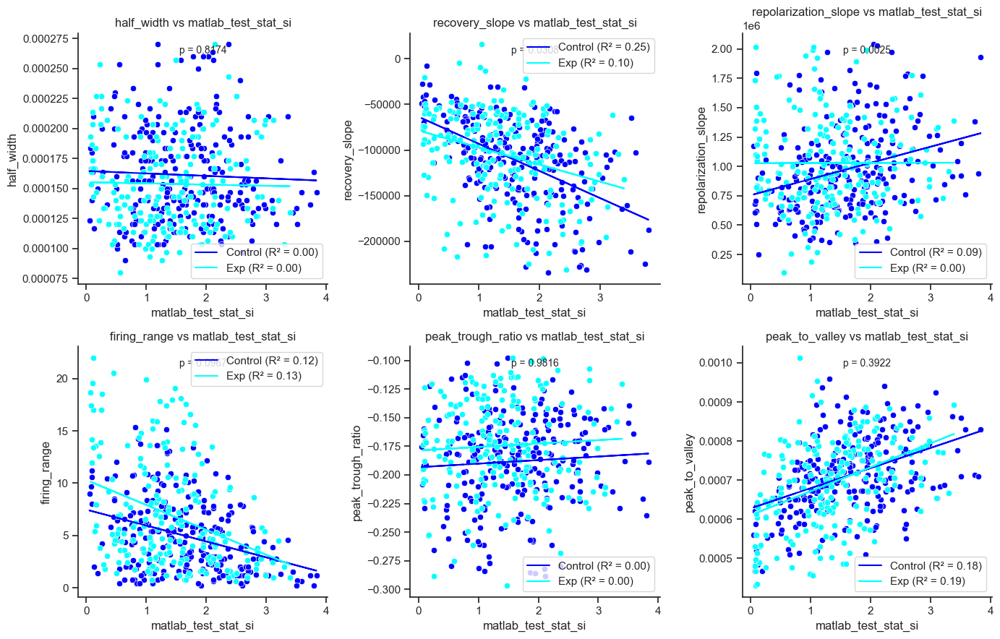


B - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0040, n = 145
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0123, n = 196
Slope difference z-statistic: 0.6409, p-value: 0.5216

B - recovery_slope (after outlier removal):
Control: slope = -17689.3535 ± 3854.2565, R² = 0.1341, n = 138
Experimental: slope = -28143.2944 ± 3888.8123, R² = 0.2179, n = 190
Slope difference z-statistic: 1.9093, p-value: 0.0562

B - repolarization_slope (after outlier removal):
Control: slope = 93115.4155 ± 41968.3324, R² = 0.0342, n = 141
Experimental: slope = 62014.7767 ± 43886.9370, R² = 0.0106, n = 189
Slope difference z-statistic: 0.5122, p-value: 0.6085

B - firing_range (after outlier removal):
Control: slope = -1.7006 ± 0.3157, R² = 0.1697, n = 144
Experimental: slope = -2.7889 ± 0.4564, R² = 0.1672, n = 188
Slope difference z-statistic: 1.9612, p-value: 0.0499

B - peak_trough_ratio (after outlier removal):
Control: slope = 0.0046 ± 0.0031, R² = 0.0173, n = 130
Exper

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


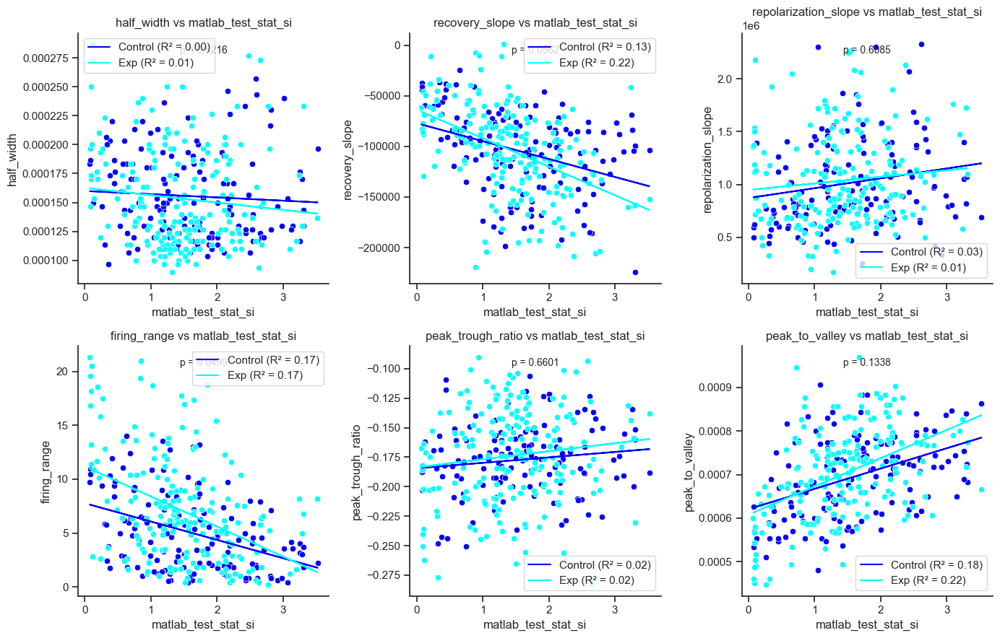


C - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0119, n = 129
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0163, n = 180
Slope difference z-statistic: 0.0866, p-value: 0.9310

C - recovery_slope (after outlier removal):
Control: slope = -24824.1666 ± 4213.0678, R² = 0.2215, n = 124
Experimental: slope = -22558.0261 ± 3456.3416, R² = 0.2032, n = 169
Slope difference z-statistic: -0.4158, p-value: 0.6775

C - repolarization_slope (after outlier removal):
Control: slope = 101511.6558 ± 39637.7546, R² = 0.0544, n = 116
Experimental: slope = 30948.8023 ± 37202.1397, R² = 0.0041, n = 170
Slope difference z-statistic: 1.2980, p-value: 0.1943

C - firing_range (after outlier removal):
Control: slope = -1.6243 ± 0.3309, R² = 0.1627, n = 126
Experimental: slope = -2.4014 ± 0.3752, R² = 0.1932, n = 173
Slope difference z-statistic: 1.5531, p-value: 0.1204

C - peak_trough_ratio (after outlier removal):
Control: slope = -0.0004 ± 0.0038, R² = 0.0001, n = 123
Ex

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


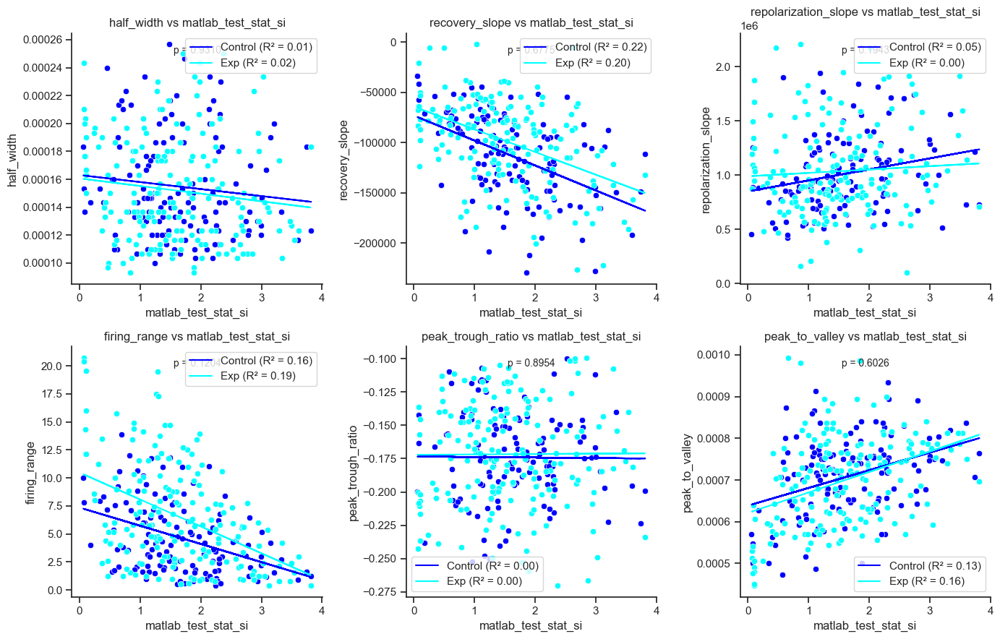


Total - half_width (after outlier removal):
Control: slope = -0.0000 ± 0.0000, R² = 0.0040, n = 526
Experimental: slope = -0.0000 ± 0.0000, R² = 0.0064, n = 583
Slope difference z-statistic: 0.2968, p-value: 0.7666

Total - recovery_slope (after outlier removal):
Control: slope = -25096.0673 ± 2158.0425, R² = 0.2102, n = 510
Experimental: slope = -22682.5376 ± 2205.9408, R² = 0.1567, n = 571
Slope difference z-statistic: -0.7821, p-value: 0.4342

Total - repolarization_slope (after outlier removal):
Control: slope = 115543.8449 ± 20032.5154, R² = 0.0627, n = 499
Experimental: slope = 30536.9988 ± 21826.4971, R² = 0.0035, n = 562
Slope difference z-statistic: 2.8693, p-value: 0.0041

Total - firing_range (after outlier removal):
Control: slope = -1.6098 ± 0.1748, R² = 0.1400, n = 523
Experimental: slope = -2.4508 ± 0.2402, R² = 0.1561, n = 565
Slope difference z-statistic: 2.8315, p-value: 0.0046

Total - peak_trough_ratio (after outlier removal):
Control: slope = 0.0029 ± 0.0020, R² =

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


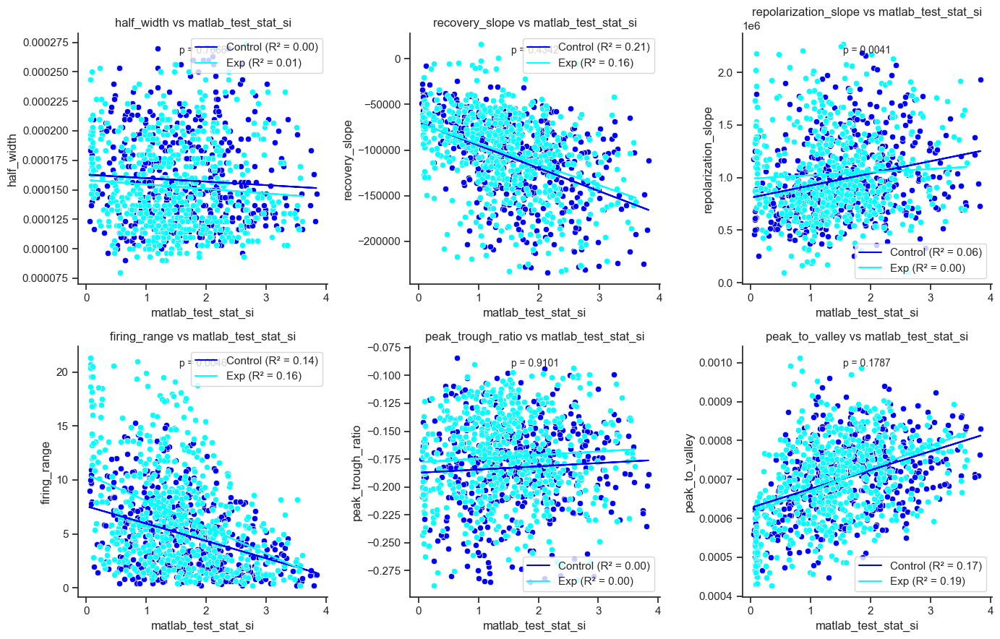

In [23]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

# [Previous data loading code remains the same until the session loop]
df_loaded = pd.read_pickle(r'Q:/sachuriga/CR_CA1_paper/tables/all_units_table.pkl')
df_good = df_loaded[df_loaded['unit_quality']=="good"]
df_py = df_good[df_good['cell_type']=="Pyramidal cells"]

base_folder = r"Q:/sachuriga/CR_CA1_paper/Results/functional_cell_type"

control_ids = ['65165', '65091', '63383', '66539', '65622']
exp_ids = ['65588', '63385', '66538', '66537', '66922']




def remove_outliers(df, column):
    """Remove outliers using IQR method"""
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

funct = ["Place cells",""]


for functional_plot in funct:
    if functional_plot :
        df = df_py[df_py['functional_cell_type']=="Place cell"]
    else:
        df = df_py
    session = ["A","B","C","Total"]
    for session in session:
        # Filter for sessions
        if session == "Total":
            df_a = df
        else:
            df_a = df[df['session'] == session]

        # Separate into control and experimental groups
        control_df = df_a[df_a['animal_id'].isin(control_ids)]
        exp_df = df_a[df_a['animal_id'].isin(exp_ids)]

        # Set Seaborn theme
        sns.set_theme(style="ticks")

        # Metrics for analysis
        metrics = ['half_width', 'recovery_slope', 'repolarization_slope', 
                'firing_range', 'peak_trough_ratio', 'peak_to_valley']
        
        metrics1 = ['matlab_test_stat_si']
        
        # Create figure with 3x2 subplots
        fig, axes = plt.subplots(2,3, figsize=(14, 9))
        axes = axes.flatten()

        # Define custom colors
        control_color = "blue"
        exp_color = "cyan"

        for idx, metric in enumerate(metrics):
            # Prepare and clean control group data
            control_data = pd.concat([control_df[metrics1[0]], control_df[metric]], axis=1).dropna()
            control_data = remove_outliers(control_data, metrics1[0])
            control_data = remove_outliers(control_data, metric)
            
            # Prepare and clean experimental group data
            exp_data = pd.concat([exp_df[metrics1[0]], exp_df[metric]], axis=1).dropna()
            exp_data = remove_outliers(exp_data, metrics1[0])
            exp_data = remove_outliers(exp_data, metric)

            if len(control_data) > 2 and len(exp_data) > 2:  # Need at least 3 points for meaningful fit
                # Linear regression for control
                control_slope, control_intercept, control_r, control_p, control_se = stats.linregress(
                    control_data[metrics1[0]], control_data[metric])
                
                # Linear regression for experimental
                exp_slope, exp_intercept, exp_r, exp_p, exp_se = stats.linregress(
                    exp_data[metrics1[0]], exp_data[metric])

                # Print results
                print(f"\n{session} - {metric} (after outlier removal):")
                print(f"Control: slope = {control_slope:.4f} ± {control_se:.4f}, R² = {control_r**2:.4f}, n = {len(control_data)}")
                print(f"Experimental: slope = {exp_slope:.4f} ± {exp_se:.4f}, R² = {exp_r**2:.4f}, n = {len(exp_data)}")

                # Test difference in slopes (using z-test)
                se_diff = np.sqrt(control_se**2 + exp_se**2)
                z_stat = (control_slope - exp_slope) / se_diff
                p_val = stats.norm.sf(abs(z_stat)) * 2  # Two-tailed test

                print(f"Slope difference z-statistic: {z_stat:.4f}, p-value: {p_val:.4f}")

                # Create scatter plot with regression lines
                # Control group
                control_plot = sns.scatterplot(
                    data=control_data, 
                    x=metrics1[0], 
                    y=metric, 
                    ax=axes[idx], 
                    color=control_color,
                    label='Control'
                )
                control_line = axes[idx].plot(control_data[metrics1[0]], 
                                            control_slope * control_data[metrics1[0]] + control_intercept, 
                                            color=control_color,
                                            label=f'Control (R² = {control_r**2:.2f})')

                # Experimental group
                exp_plot = sns.scatterplot(
                    data=exp_data, 
                    x=metrics1[0], 
                    y=metric, 
                    ax=axes[idx], 
                    color=exp_color,
                    label='Experimental'
                )
                exp_line = axes[idx].plot(exp_data[metrics1[0]], 
                                        exp_slope * exp_data[metrics1[0]] + exp_intercept, 
                                        color=exp_color,
                                        label=f'Exp (R² = {exp_r**2:.2f})')

                # Customize plot
                axes[idx].set_title(f'{metric} vs {metrics1[0]}')
                axes[idx].set_xlabel(metrics1[0])
                axes[idx].set_ylabel(metric)
                
                # Update legend with R² values
                axes[idx].legend(handles=[control_line[0], exp_line[0]],
                            labels=[f'Control (R² = {control_r**2:.2f})', 
                                    f'Exp (R² = {exp_r**2:.2f})'])
                
                # Add p-value
                axes[idx].text(0.5, 0.95, f'p = {p_val:.4f}', 
                            horizontalalignment='center', 
                            verticalalignment='top', 
                            transform=axes[idx].transAxes, 
                            fontsize=10)

                # Remove top and right spines
                axes[idx].spines['top'].set_visible(False)
                axes[idx].spines['right'].set_visible(False)

        # Save the figure
        fig.savefig(fr'{base_folder}/{session}_linear_fits_pyramidal_no_outliers_{functional_plot}.eps', format='eps', bbox_inches='tight')
        fig.savefig(fr'{base_folder}/{session}_linear_fits_pyramidal_no_outliers_{functional_plot}.png', format='png', bbox_inches='tight')

        # Adjust layout and show
        plt.tight_layout()
        plt.show()